# Data Vizualization

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# from datetime import datetime
# from datetime import timedelta
# import numpy as np

In [2]:
df = pd.read_csv('./artifacts/df_rides.csv', index_col=0)
df.reset_index(drop=True, inplace=True)
duration = pd.to_timedelta(df['duration_dt'])
df['duration_min_float'] = duration.dt.total_seconds() / 60
# df['datetime'] = pd.to_datetime(df['datetime'])
# df['duration_dt'] = pd.to_timedelta(df['duration_dt'])

In [3]:
df.select_dtypes(include=['float64']).describe().T

,count,mean,std,min,25%,50%,75%,max
total_earning,3106.0,24.031037,16.573203,5.620000,12.800000,19.260000,29.835000,203.470000
base_fare,3106.0,22.666719,16.230436,5.620000,11.922500,17.795000,27.885000,203.470000
customer_fare,3106.0,35.011980,22.996744,8.580000,19.840000,28.765000,43.480000,374.870000
paid_to_driver,3106.0,24.669301,16.848513,5.620000,13.245000,20.005000,30.597500,209.470000
paid_to_uber,3106.0,9.591690,8.461695,-42.080000,5.150000,8.060000,12.835000,123.400000
distance_km,3106.0,6.526220,7.130251,0.020000,2.330000,4.215000,8.077500,110.550000
fee,3106.0,27.890808,14.827361,-85.273091,21.227895,34.550489,38.794046,41.131956
earning_pct,3106.0,70.028322,10.842473,32.239156,61.055754,65.135683,77.064336,133.773165
earning_base_fare_pct,3106.0,63.643565,9.462541,23.446659,59.974899,61.765504,66.603208,133.773165
traffic_benchmark,3106.0,3.587073,1.654064,0.805066,2.602176,3.348431,4.287037,50.833333


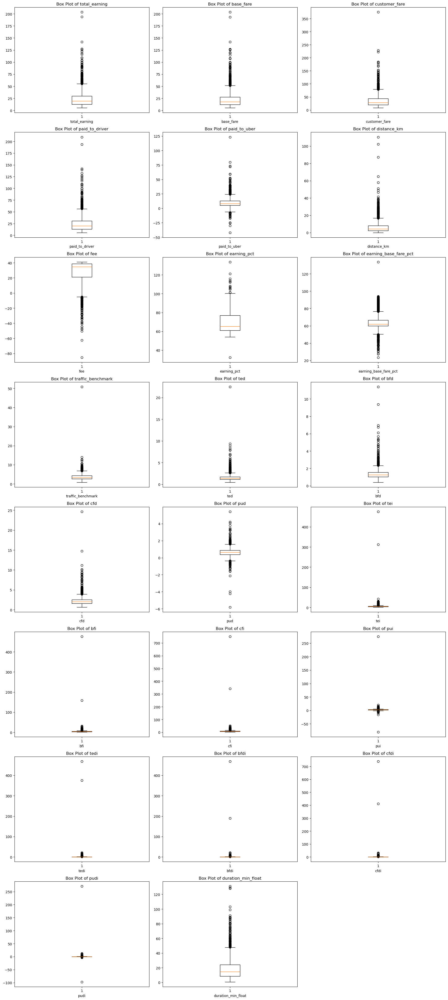

In [4]:
float_columns = df.select_dtypes(include=['float64']).columns
num_cols = len(float_columns)
num_rows = (num_cols // 3) + (num_cols % 3 > 0)  # Calculate number of rows needed

fig, axs = plt.subplots(num_rows, 3, figsize=(18, num_rows * 5))  # Adjust figsize as needed
axs = axs.flatten()  # Flatten the array of axes for easy iteration

for i, col in enumerate(float_columns):
    axs[i].boxplot(df[col])
    axs[i].set_title(f'Box Plot of {col}')
    axs[i].set_xlabel(col)

# Hide any unused subplots
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.show()

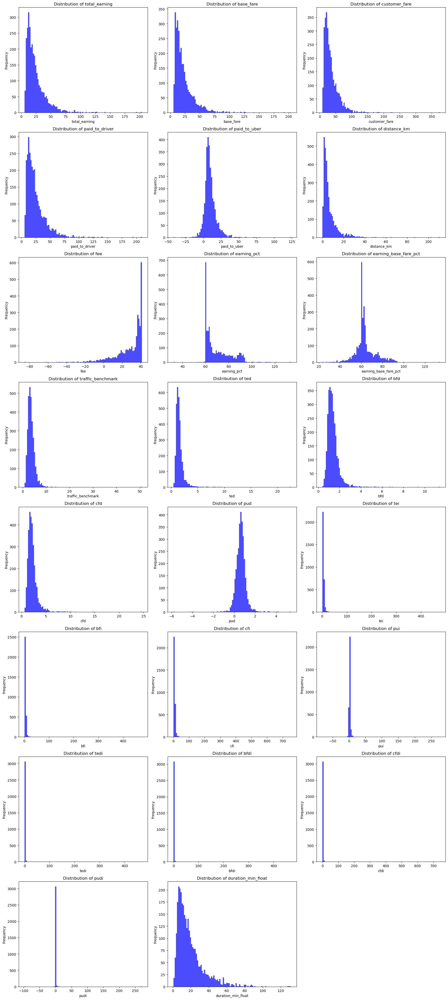

In [5]:
fig, axs = plt.subplots(num_rows, 3, figsize=(18, num_rows * 5))  # Adjust figsize as needed
axs = axs.flatten()  # Flatten the array of axes for easy iteration

for i, col in enumerate(float_columns):
    axs[i].hist(df[col], bins=100, alpha=0.7, color='blue')
    axs[i].set_title(f'Distribution of {col}')
    axs[i].set_xlabel(col)
    axs[i].set_ylabel('Frequency')

# Hide any unused subplots
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.show()


In [6]:
df[float_columns].skew()

total_earning             2.593450
base_fare                 2.728477
customer_fare             3.058519
paid_to_driver            2.606904
paid_to_uber              2.071630
distance_km               4.157961
fee                      -1.800781
earning_pct               1.005114
earning_base_fare_pct     0.732412
traffic_benchmark         8.384493
ted                       7.913729
bfd                       4.688539
cfd                       5.460365
pud                      -0.373867
tei                      36.621016
bfi                      44.544540
cfi                      40.800386
pui                      39.471028
tedi                     39.334630
bfdi                     46.338625
cfdi                     42.738671
pudi                     43.380928
duration_min_float        2.012153
dtype: float64

In [7]:
def adaptive_outlier_removal(df, z_threshold=3, show_impact=True):
    """
    Automatically selects IQR or Z-score based on skewness.
    Returns cleaned DataFrame and method usage report.
    """
    from scipy.stats import skew, zscore
    
    METHOD_REPORT = {}
    clean_df = df.copy()
    clean_col_df = clean_df.copy()
    
    # Business constraints (adjust per domain knowledge)
    BUSINESS_LIMITS = {
        'duration_min_float': (1, 180),       # 1min to 3hrs
        #'distance_km': (0.1, 50),          # 100m to 50km  
        #'total_fare': (2.0, 200),
        #'surge_multiplier': (1.0, 5.0)
    }
    
    # Apply business rules first
    for col in clean_df.select_dtypes(include='number'):
        if col in BUSINESS_LIMITS:
            min_val, max_val = BUSINESS_LIMITS[col]
            mask = (clean_df[col] >= min_val) & (clean_df[col] <= max_val)
            clean_df = clean_df[mask]
    
    # Outlier removal
    for col in clean_df.select_dtypes(include='number'):        
        # Calculate skewness
        col_skew = skew(clean_df[col].dropna())
        METHOD = 'IQR' if abs(col_skew) > 1 else 'Z-score'
        
        # Apply selected method
        if METHOD == 'IQR':
            q1 = clean_df[col].quantile(0.25)
            q3 = clean_df[col].quantile(0.75)
            iqr = q3 - q1
            lower = q1 - 1.5*iqr
            upper = q3 + 1.5*iqr
        else: # Z-score
            z_scores = zscore(clean_df[col].dropna())
            lower = -z_threshold
            upper = z_threshold
            # Align z-scores with original scale
            lower = clean_df[col].mean() + lower*clean_df[col].std()
            upper = clean_df[col].mean() + upper*clean_df[col].std()
        
        # Apply bounds
        mask = (clean_df[col] >= lower) & (clean_df[col] <= upper)
        outliers_removed = len(clean_df) - mask.sum()
        clean_col_df = clean_df[mask]
        clean_skew = skew(clean_col_df[col].dropna())
        
        # Store metrics
        METHOD_REPORT[col] = {
            'method': METHOD,
            'skewness': round(col_skew, 2),
            'outliers_removed': outliers_removed,
            'bounds': (round(lower,2), round(upper,2)),
            'retained': len(clean_col_df),
        }
        
        # Visual comparison
        if show_impact:
            fig, ax = plt.subplots(1,2, figsize=(14,5))
            sns.histplot(df[col], ax=ax[0], color='red', kde=True)
            ax[0].set_title(f'Original {col}\n(Skew: {skew(df[col]):.2f})')
            sns.histplot(clean_col_df[col], ax=ax[1], color='green', kde=True)
            ax[1].set_title(f'Cleaned {col}\n({METHOD} | Skew: {clean_skew:.2f})')
            plt.tight_layout()
            plt.show()
    
    # Print summary
    print(pd.DataFrame(METHOD_REPORT).T)
    return clean_df

# Usage:
viz_df = adaptive_outlier_removal(df, show_impact=False)

                        method skewness outliers_removed           bounds  \
total_earning              IQR     2.59              155   (-12.76, 55.4)   
base_fare                  IQR     2.73              180  (-12.01, 51.83)   
customer_fare              IQR     3.06              134  (-15.62, 78.94)   
paid_to_driver             IQR     2.61              153   (-12.8, 56.64)   
paid_to_uber               IQR     2.07              189   (-6.38, 24.38)   
distance_km                IQR     4.16              223     (-6.3, 16.7)   
fee                        IQR     -1.8              127   (-5.11, 65.14)   
earning_pct                IQR     1.01               14  (37.09, 100.99)   
earning_base_fare_pct  Z-score     0.73               27   (35.27, 92.03)   
traffic_benchmark          IQR     8.47              100     (0.07, 6.81)   
ted                        IQR     3.46              178     (0.18, 2.65)   
bfd                        IQR     3.57              131     (0.25, 2.35)   

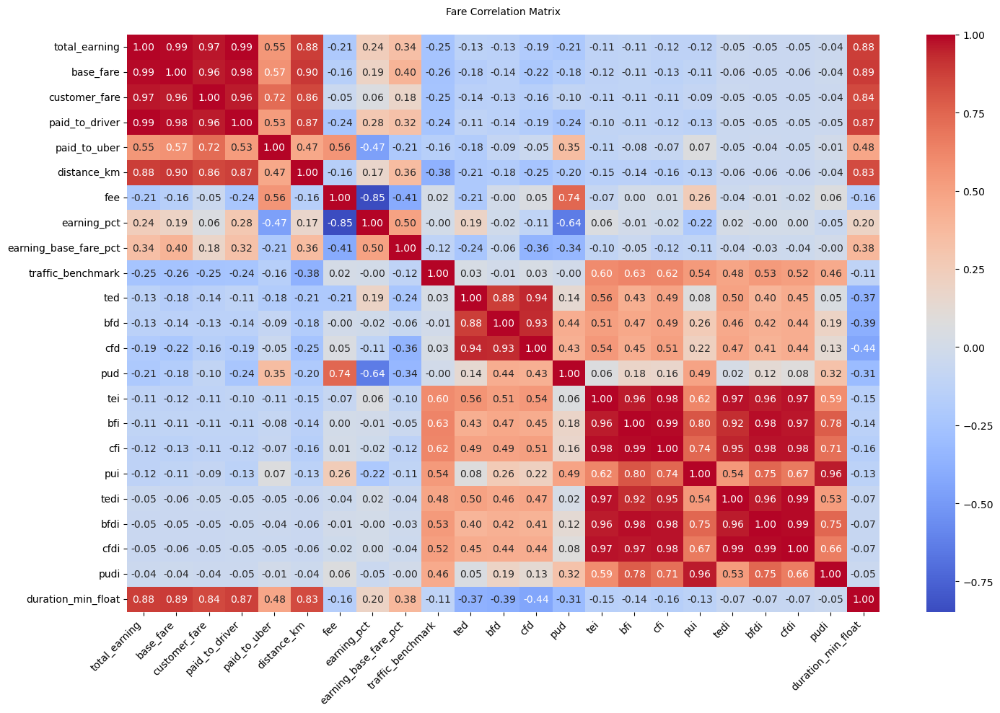

In [8]:
corr_matrix = df.select_dtypes(include='number').corr()

plt.figure(figsize=(15,10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', 
           annot_kws={"size":10}, fmt=".2f",)
           #mask=np.triu(np.ones_like(corr_matrix, dtype=bool)))
plt.title("Fare Correlation Matrix", pad=20, fontsize=10)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

In [9]:
# Outlier removal based on top features
def earnings_aware_outlier_removal(df, 
                                   target_col='tedi', 
                                   number_of_features=4, 
                                   n_estimators=100, 
                                   show_impact=False,
                                   show_report=False):
    """
    Prioritizes outlier removal based on feature impact on 'ted' (total earnings per duration).
    Returns cleaned DataFrame and impact report.
    """
    from sklearn.ensemble import RandomForestRegressor

    # 1. Calculate feature earnings impact on 'ted'
    X = df.select_dtypes(include='number').drop(columns=[target_col], errors='ignore')
    y = df[target_col]

    model = RandomForestRegressor(n_estimators=n_estimators) # Increased estimators for robustness
    model.fit(X, y)
    feature_impact = pd.Series(model.feature_importances_, index=X.columns)
    top_features = feature_impact.nlargest(number_of_features).index.tolist() # Top 5 features as requested
    top_features.insert(0, target_col)
    
    # 2. Adaptive outlier removal
    def adaptive_outlier_removal(df, 
                                 z_threshold=3, 
                                 show_impact=show_impact, 
                                 top_features=top_features,
                                 show_report=show_report):
        """
        Automatically selects IQR or Z-score based on skewness.
        Returns cleaned DataFrame and method usage report.
        """
        from scipy.stats import skew, zscore
        
        METHOD_REPORT = {}
        clean_df = df.copy()
        
        # Business constraints (adjust per domain knowledge)
        BUSINESS_LIMITS = {
            'duration_min_float': (1, 180),       # 1min to 3hrs
            #'distance_km': (0.1, 50),          # 100m to 50km  
            #'total_fare': (2.0, 200),
            #'surge_multiplier': (1.0, 5.0)
        }
        
        # Apply business rules first
        for col in clean_df.select_dtypes(include='number'):
            if col in BUSINESS_LIMITS:
                min_val, max_val = BUSINESS_LIMITS[col]
                mask = (clean_df[col] >= min_val) & (clean_df[col] <= max_val)
                clean_df = clean_df[mask]
        
        # Outlier removal
        for col in clean_df[top_features].columns:        
            # Calculate skewness
            col_skew = skew(clean_df[col].dropna())
            METHOD = 'IQR' if abs(col_skew) > 1 else 'Z-score'
            
            # Apply selected method
            if METHOD == 'IQR':
                q1 = clean_df[col].quantile(0.25)
                q3 = clean_df[col].quantile(0.75)
                iqr = q3 - q1
                lower = q1 - 1.5*iqr
                upper = q3 + 1.5*iqr
            else: # Z-score
                z_scores = zscore(clean_df[col].dropna())
                lower = -z_threshold
                upper = z_threshold
                # Align z-scores with original scale
                lower = clean_df[col].mean() + lower*clean_df[col].std()
                upper = clean_df[col].mean() + upper*clean_df[col].std()
            
            # Apply bounds
            mask = (clean_df[col] >= lower) & (clean_df[col] <= upper)
            outliers_removed = len(clean_df) - mask.sum()
            clean_df = clean_df[mask]
            clean_skew = skew(clean_df[col].dropna())
            
            # Store metrics
            METHOD_REPORT[col] = {
                'method': METHOD,
                'skewness': round(col_skew, 2),
                'outliers_removed': outliers_removed,
                'bounds': (round(lower,2), round(upper,2)),
                'retained': len(clean_df),
            }
            
            # Visual comparison
            if show_impact:
                fig, ax = plt.subplots(1,2, figsize=(14,5))
                sns.histplot(df[col], ax=ax[0], color='red', kde=True)
                ax[0].set_title(f'Original {col}\n(Skew: {skew(df[col]):.2f})')
                sns.histplot(clean_df[col], ax=ax[1], color='green', kde=True)
                ax[1].set_title(f'Cleaned {col}\n({METHOD} | Skew: {clean_skew:.2f})')
                plt.tight_layout()
                plt.show()
        
        # Print summary
        if show_report:
            print(pd.DataFrame(METHOD_REPORT).T)
        return clean_df
    
    clean_df = adaptive_outlier_removal(df)
    return clean_df

clean_df = earnings_aware_outlier_removal(df)

# Business Impact Analysis:
print(f"Original records: {len(df):,}")
print(f"Cleaned records: {len(clean_df):,}")
print(f"Data retention: {len(clean_df)/len(df):.1%}")

Original records: 3,106
Cleaned records: 2,445
Data retention: 78.7%


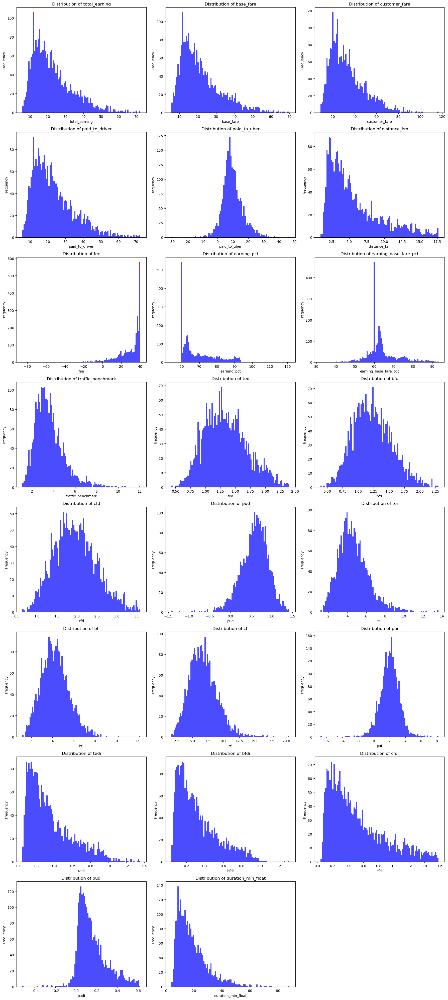

In [10]:
fig, axs = plt.subplots(num_rows, 3, figsize=(18, num_rows * 5))  # Adjust figsize as needed
axs = axs.flatten()  # Flatten the array of axes for easy iteration

for i, col in enumerate(float_columns):
    axs[i].hist(clean_df[col], bins=100, alpha=0.7, color='blue')
    axs[i].set_title(f'Distribution of {col}')
    axs[i].set_xlabel(col)
    axs[i].set_ylabel('Frequency')

# Hide any unused subplots
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()

In [11]:
clean_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2445 entries, 0 to 3105
Data columns (total 34 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   type                   2445 non-null   object 
 1   date                   2445 non-null   object 
 2   time                   2445 non-null   object 
 3   duration               2445 non-null   object 
 4   distance               2445 non-null   object 
 5   origin                 2445 non-null   object 
 6   destination            2445 non-null   object 
 7   total_earning          2445 non-null   float64
 8   base_fare              2445 non-null   float64
 9   customer_fare          2445 non-null   float64
 10  paid_to_driver         2445 non-null   float64
 11  paid_to_uber           2445 non-null   float64
 12  datetime               2445 non-null   object 
 13  duration_dt            2445 non-null   object 
 14  distance_km            2445 non-null   float64
 15  origin_la

In [12]:
clean_df['type'].unique()

array(['UberX', 'Comfort', 'Prioridade', 'Flash', 'Black', 'Black Bag',
       'Comfort Planet', 'VIP', 'Business Comfort'], dtype=object)

In [13]:
clean_df['datetime'] = pd.to_datetime(clean_df['datetime'])

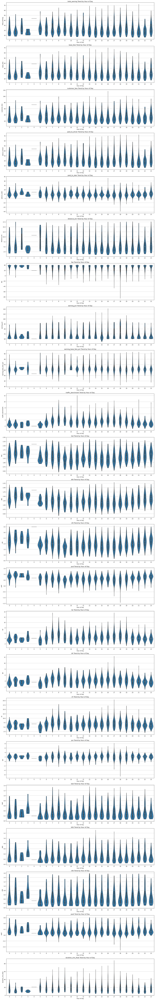

In [14]:
# Extract hour of the day
clean_df['hour_of_day'] = clean_df['datetime'].dt.hour

float_columns = clean_df.select_dtypes(include=['float64']).columns

num_cols = len(float_columns)
num_rows = (num_cols // 1) + (num_cols % 1 > 0)

fig, axs = plt.subplots(num_rows, ncols=1, figsize=(18, num_rows * 5))
axs = axs.flatten()

for i, col in enumerate(float_columns):
    sns.violinplot(x='hour_of_day', y=col, data=clean_df, ax=axs[i], cut=0) # Violin plot with hour on x-axis 
    axs[i].set_title(f'{col} Trend by Hour of Day')
    axs[i].set_xlabel('Hour of Day')
    axs[i].set_ylabel(col)
    axs[i].set_xticks(range(24)) # Ensure all hours are shown
    axs[i].yaxis.grid(True)

for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.show()

In [19]:
clean_df.head().T

,0,1,2,3,6
type,UberX,UberX,UberX,UberX,UberX
date,2023-11-11,2023-11-11,2023-11-11,2023-11-11,2023-11-11
time,17:28:00,16:37:00,16:19:00,15:57:00,12:32:00
duration,11 min 32 sec,27 min 43 sec,16 min 18 sec,5 min 29 sec,21 min 33 sec
distance,4.15 km,13.42 km,4.78 km,1.38 km,5.28 km
origin,"Rua Antônio das Chagas, Santo Amaro - São Paul...","Rua Helena, Itaim Bibi - São Paulo - SP, 04552...","Alameda Gabriel Monteiro da Silva, Jardim Amer...","R. Turiassu, Perdizes - São Paulo - SP, 05005-...","Rua Capital Federal, Perdizes - São Paulo - SP..."
destination,"R. Geórgia, Brooklin - São Paulo - SP, 04559-0...","Rua Quipa, Campo Limpo - São Paulo - SP, 05756...","Rua Helena, Itaim Bibi - São Paulo - SP, 04552...","Rua Ministro Godói, Perdizes - São Paulo - SP,...","Av. Rebouças, Bairro Pinheiros - São Paulo - S..."
total_earning,15.01,27.09,13.78,6.69,20.0
base_fare,11.01,27.09,13.78,6.69,20.0
customer_fare,19.97,34.95,22.96,10.96,24.88


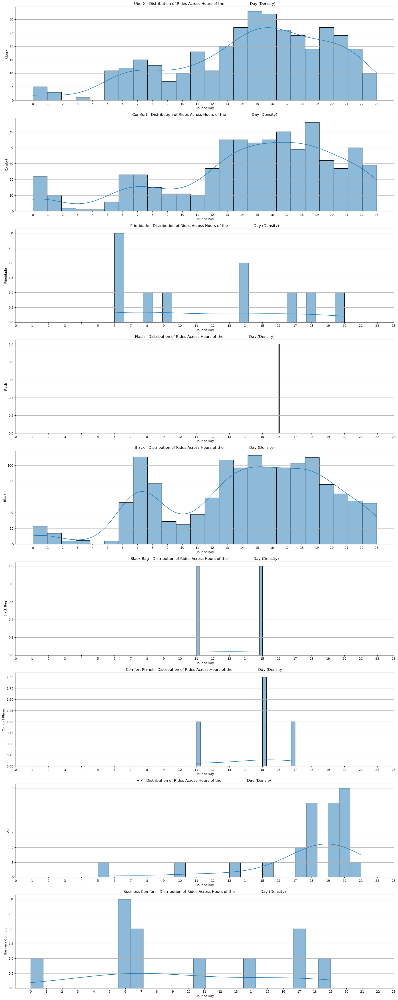

In [23]:
types = clean_df['type'].unique()

num_cols = len(types)
num_rows = num_cols #(num_cols // 1) + (num_cols % 1 > 0)

fig, axs = plt.subplots(num_rows, ncols=1, figsize=(18, num_rows * 5))
axs = axs.flatten()

for i, type_ in enumerate(types):
    data = clean_df[clean_df['type'] == type_]
    sns.histplot(x='hour_of_day', data=data, bins=24, kde=True, 
                 legend=True, stat='count', fill=True, ax=axs[i])
    axs[i].set_title(f'{type_} - Distribution of Rides Across Hours of the\
                      Day (Density)')
    axs[i].set_xlabel('Hour of Day')
    axs[i].set_ylabel(type_)
    axs[i].set_xticks(range(24)) # Ensure all hours are shown
    axs[i].yaxis.grid(True)

for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.show()

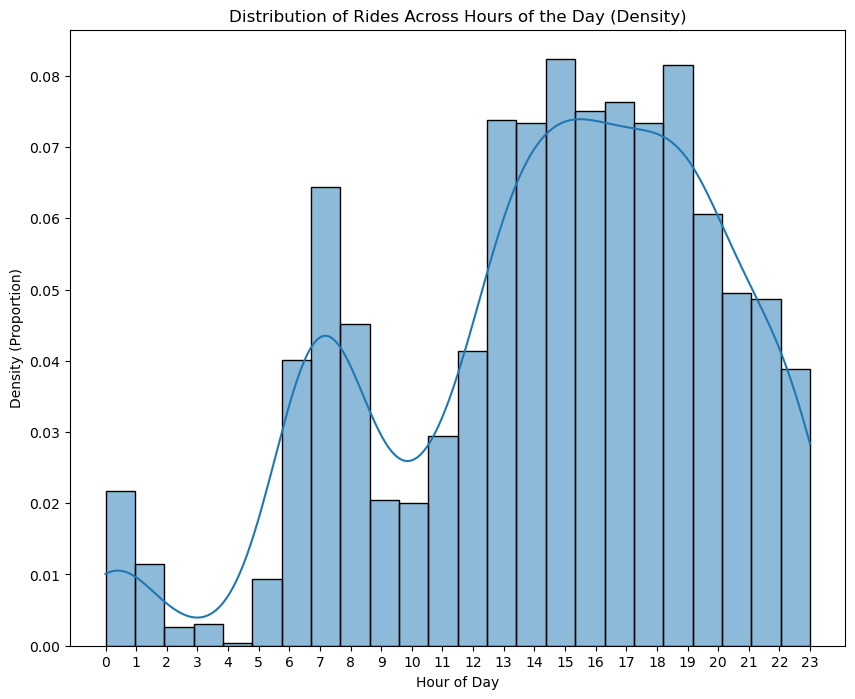

In [24]:
# Extract hour of the day
clean_df['hour_of_day'] = clean_df['datetime'].dt.hour

figure = plt.figure(figsize=(10, 8))
sns.histplot(x='hour_of_day', data=clean_df, bins=24, kde=True, legend=False, stat='density', fill=True)
plt.title('Distribution of Rides Across Hours of the Day (Density)')
plt.xlabel('Hour of Day')
plt.ylabel('Density (Proportion)')

plt.xticks(range(24)) # Ensure all hours are shown
plt.show()

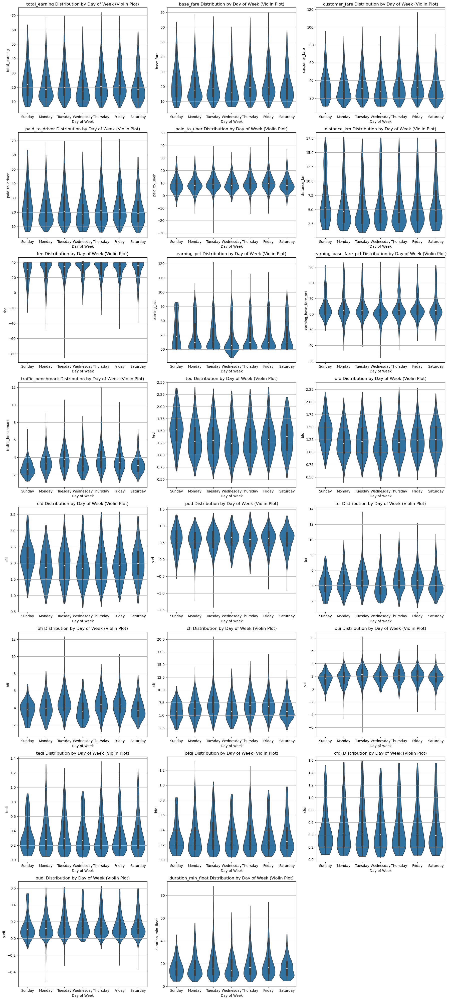

In [25]:
clean_df['datetime_dt'] = pd.to_datetime(clean_df['datetime'])
clean_df['day_of_week'] = clean_df['datetime_dt'].dt.day_name() # Or use .dt.weekday for numerical day of week

float_columns = clean_df.select_dtypes(include=['float64']).columns

num_cols = len(float_columns)
num_rows = (num_cols // 3) + (num_cols % 3 > 0)

fig, axs = plt.subplots(num_rows, 3, figsize=(18, num_rows * 5))
axs = axs.flatten()

day_order = ['Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 
             'Friday', 'Saturday'] # For ordered days

for i, col in enumerate(float_columns):
    sns.violinplot(x='day_of_week', y=col, data=clean_df, ax=axs[i], cut=0, order=day_order) # Violin plot by day of week, ordered days
    axs[i].set_title(f'{col} Distribution by Day of Week (Violin Plot)')
    axs[i].set_xlabel('Day of Week')
    axs[i].set_ylabel(col)
    axs[i].yaxis.grid(True)

for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.show()

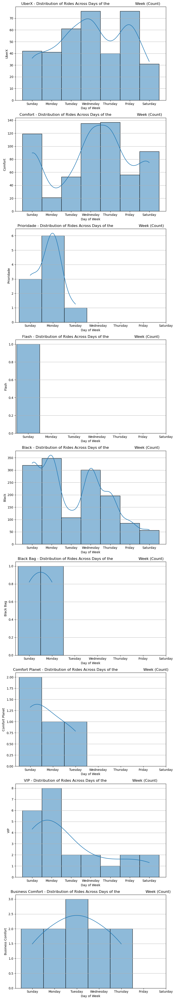

In [32]:
clean_df['datetime_dt'] = pd.to_datetime(clean_df['datetime'])
clean_df['day_of_week'] = clean_df['datetime_dt'].dt.day_name() # Or use .dt.weekday for numerical day of week
day_order = ['Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 
             'Friday', 'Saturday'] # For ordered days

types = clean_df['type'].unique()

num_cols = len(types)
num_rows = num_cols #(num_cols // 1) + (num_cols % 1 > 0)

fig, axs = plt.subplots(num_rows, ncols=1, figsize=(8, num_rows * 5))
axs = axs.flatten()

for i, type_ in enumerate(types):
    data = clean_df[clean_df['type'] == type_]
    sns.histplot(x='day_of_week', data=data, bins=7, kde=True, 
                 legend=True, stat='count', fill=True, ax=axs[i])
    axs[i].set_title(f'{type_} - Distribution of Rides Across Days of the\
                      Week (Count)')
    axs[i].set_xlabel('Day of Week')
    axs[i].set_ylabel(type_)
    axs[i].set_xticks(range(7), labels=day_order) # Ensure all hours are shown
    axs[i].yaxis.grid(True)

for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.show()

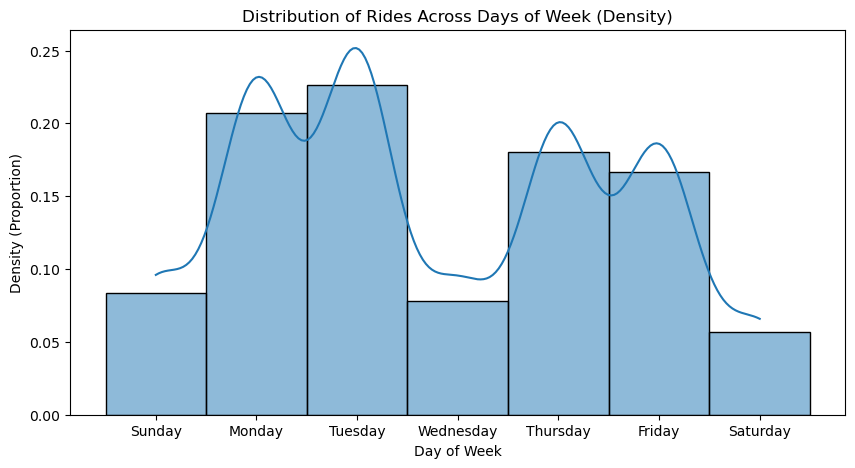

In [30]:
clean_df['datetime_dt'] = pd.to_datetime(clean_df['datetime'])
clean_df['day_of_week'] = clean_df['datetime_dt'].dt.day_name() # Or use .dt.weekday for numerical day of week
day_order = ['Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 
             'Friday', 'Saturday'] # For ordered days

figure = plt.figure(figsize=(10, 5))
sns.histplot(x='day_of_week', data=clean_df, bins=7, kde=True, legend=False, 
             stat='density')
plt.title('Distribution of Rides Across Days of Week (Density)')
plt.xlabel('Day of Week')
plt.ylabel('Density (Proportion)')

plt.xticks(range(7), day_order) # Ensure all days are shown in the correct order
plt.show()

In [18]:
import geopandas as gpd

# Load the GeoDataFrame
geodf = gpd.read_parquet('./data/br_geo_gdf.parquet')

# Load data for geodf
scdf = pd.read_csv('./data/br_data.csv')
scdf =scdf[scdf['Nome_da_UF '] == 'São Paulo']

# Merge the GeoDataFrame with the DataFrame
geodf['Cod_setor'] = geodf['Cod_setor'].astype('str')
scdf['Cod_setor'] = scdf['Cod_setor'].astype('str')
gdf = pd.merge(scdf, geodf, how='left', on='Cod_setor')

# Filter data for family earnings and density
filtered_gdf = gdf[(gdf['renda_dom'] >= 4.418) & (gdf['densidade'] >= 150)]
filtered_gdf = gpd.GeoDataFrame(filtered_gdf, geometry='geometry')

borders_style = {
        'color': 'green',
        'weight': 0,
        'fillColor': 'green',
        'fillOpacity': 0.3,
    }

In [19]:
import folium
from folium.plugins import HeatMap

# 1. Parse 'origin_lat_lng' into separate lat and lng columns
clean_df['origin_lat'] = round(clean_df['origin_lat_lng'].str.replace('[', '').\
    str.replace(']', '').str.split(',', expand=True)[0].astype(float),6)
clean_df['origin_lng'] = round(clean_df['origin_lat_lng'].str.replace('[', '').\
    str.replace(']', '').str.split(',', expand=True)[1].astype(float),6)

# 2. Aggregate 'tedi' by location (you can group by lat/lng combinations)
location = clean_df.groupby(['origin_lat', 'origin_lng']).agg({'ted': 'mean'}).reset_index()

# 3. Create a Folium map centered around the average latitude and longitude
map_center_lat = location['origin_lat'].mean()
map_center_lng = location['origin_lng'].mean()

ride_map = folium.Map(location=[map_center_lat, map_center_lng], 
                      zoom_start=12,
                      tiles='Cartodb Positron') # Adjust zoom_start as needed

# 4. Create Heatmap layer to visualize 'tedi' intensity
heat_data = [[row['origin_lat'], row['origin_lng'], row['ted']] for index, row in location.iterrows()]

HeatMap(heat_data).add_to(ride_map)

# 5. Create population density and earnings layer
folium.GeoJson(filtered_gdf, style_function=lambda x: borders_style).add_to(ride_map)


# Display the map (in a notebook environment, it will render directly)
ride_map.save("./artifacts/ride_efficiency_map.html") # Save to HTML file to view in browser
print("Map saved to ride_efficiency_map.html")

Map saved to ride_efficiency_map.html


In [20]:
ride_map

In [58]:
import folium
from folium.plugins import HeatMap
from sklearn.cluster import DBSCAN
import numpy as np
import geopandas as gpd

# Load the GeoDataFrame
geodf = gpd.read_parquet('./data/br_geo_gdf.parquet')

# Load data for geodf
scdf = pd.read_csv('./data/br_data.csv')
scdf =scdf[scdf['Nome_da_UF '] == 'São Paulo']

# Merge the GeoDataFrame with the DataFrame
geodf['Cod_setor'] = geodf['Cod_setor'].astype('str')
scdf['Cod_setor'] = scdf['Cod_setor'].astype('str')
gdf = pd.merge(scdf, geodf, how='left', on='Cod_setor')

# Filter data for family earnings and density
filtered_gdf = gdf[(gdf['renda_dom'] >= 4.418) & (gdf['densidade'] >= 150)]
filtered_gdf = gpd.GeoDataFrame(filtered_gdf, geometry='geometry')

borders_style = {
        'color': 'green',
        'weight': 0,
        'fillColor': 'green',
        'fillOpacity': 0.3,
    }

# 1. Parse 'origin_lat_lng' into separate lat and lng columns
clean_df['origin_lat'] = round(clean_df['origin_lat_lng'].str.replace('[', '').\
    str.replace(']', '').str.split(',', expand=True)[0].astype(float),6)
clean_df['origin_lng'] = round(clean_df['origin_lat_lng'].str.replace('[', '').\
    str.replace(']', '').str.split(',', expand=True)[1].astype(float),6)

# 2. Apply DBSCAN clustering
coords = clean_df[['origin_lat', 'origin_lng']].values
db = DBSCAN(eps=0.00045, min_samples=1).fit(coords)  # Adjust eps and min_samples as needed
clean_df['cluster'] = db.labels_

# 3. Aggregate 'tedi' by cluster
clustered_location = clean_df.groupby('cluster').agg({
    'origin_lat': 'mean',
    'origin_lng': 'mean',
    'ted': 'mean'
}).reset_index()

# 4. Create a Folium map centered around the average latitude and longitude
map_center_lat = clustered_location['origin_lat'].mean()
map_center_lng = clustered_location['origin_lng'].mean()

ride_map = folium.Map(location=[map_center_lat, map_center_lng], 
                      zoom_start=12,
                      tiles='Cartodb Positron') # Adjust zoom_start as needed

# 5. Create Heatmap layer to visualize 'tedi' intensity
heat_data = [[row['origin_lat'], row['origin_lng'], row['ted']] for index, row in clustered_location.iterrows()]

HeatMap(heat_data, radius=50).add_to(ride_map)

# 5. Create population density and earnings layer
folium.GeoJson(filtered_gdf, style_function=lambda x: borders_style).add_to(ride_map)


# Display the map (in a notebook environment, it will render directly)
ride_map.save("./artifacts/ride_efficiency_map.html") # Save to HTML file to view in browser
print("Map saved to ride_efficiency_map.html")

In [21]:
clean_df.to_csv('./artifacts/clean_df.csv')